# EV Charging Infrastructure Data Collection and Integration

This notebook handles comprehensive data collection and validation from multiple authoritative sources:

1. Geographic and Infrastructure Data:
   - KWC-CMA boundary
   - Census tract boundaries
   - Land use and zoning
   - Transportation networks
   - Existing charging stations
   - Potential locations
   - EV ownership patterns

1. Population and Demographics:
   - Population density
   - Income distribution
   - Employment patterns
   - Transit accessibility

Sources:
- [Region of Waterloo Open Data](https://rowopendata-rmw.opendata.arcgis.com/) (Primary)
- [Statistics Canada, Census 2021](https://www12.statcan.gc.ca/census-recensement/2021/as-sa/fogs-spg/Page.cfm?lang=E&topic=1&dguid=2021S0503541) (Demographics)
- [OpenStreetMap](https://www.openstreetmap.org) (Geographic context)
- [OpenChargeMap](https://openchargemap.org) (Charging stations)
- [Ontario Data](https://data.ontario.ca/dataset/electric-vehicles-in-ontario-by-forward-sortation-area) (EV Census)

In [16]:
# Setup and imports
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from datetime import datetime
import logging
import warnings
from tabulate import tabulate
import branca.colormap as cm

# Local imports
from src.data.data_manager import DataManager
from src.data.constants import *
from src.data.utils import *
from src.visualization.map_viz import *

# ANSI color codes
COLORS = {
    'BOLD': '\033[1m',
    'GREEN': '\033[92m',
    'RED': '\033[91m',
    'BLUE': '\033[94m',
    'YELLOW': '\033[93m',
    'ENDC': '\033[0m'
}

# Configure logging and warnings
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)
warnings.filterwarnings('ignore', category=UserWarning)

# Initialize data manager
data_mgr = DataManager()

print("Setup complete!")

Setup complete!


## 1. Region Definition
First, let's establish our study area by fetching and validating the KWC-CMA boundary.

In [17]:
# Fetch CMA boundary
print("\033[1mFetching KWC-CMA boundary...\033[0m")
print("=" * 80)
try:
    boundary = data_mgr.get_cma_boundary()
    
    # Calculate area
    area_km2 = float(boundary.to_crs({'proj':'cea'}).geometry.area.sum() / 1_000_000)
    
    # Display region information
    print("\n📍 Region Statistics:")
    print(f"Total Area: {area_km2:.1f} km²")
    
    # Get actual bounds
    bounds = boundary.total_bounds
    print(f"\nBounds:")
    print(f"- North: {bounds[3]:.4f}")
    print(f"- South: {bounds[1]:.4f}")
    print(f"- East:  {bounds[2]:.4f}")
    print(f"- West:  {bounds[0]:.4f}")
    
    # Create base map
    m = create_kwc_map(title="The Region of Waterloo Boundaries", kwc=True)
    draw_map(m)

except Exception as e:
    print(f"\033[91m❌ Error: {str(e)}\033[0m")
    print("Unable to fetch boundary data. Please check API access.")

Fetching KWC-CMA boundary...

📍 Region Statistics:
Total Area: 1384.1 km²

Bounds:
- North: 43.6896
- South: 43.2668
- East:  -80.1893
- West:  -80.8690


## 2. Infrastructure Data Collection
Now let's collect data about existing infrastructure and potential locations.

In [18]:
print("\033[1mCollecting Infrastructure Data\033[0m")
print("=" * 80)

# Fetch charging station data
print("\n📍 Charging Stations:")
stations_df = data_mgr.fetch_charging_stations()
print(f"  \033[92m✓\033[0m Found {len(stations_df)} existing stations!")

print("\n📍 Potential Locations:")
potential_df = data_mgr.fetch_potential_locations()  # This will have its own formatted output

print("\n📊 Infrastructure Summary:")
print("-" * 50)
print(f"Existing Stations: {len(stations_df)}")
print(f"Potential Locations: {len(potential_df)}")

print("\n📊 Charging Types Distribution:")
for type_name, count in stations_df['charger_type'].value_counts().items():
    print(f"  \033[94m●\033[0m {type_name}: {count}")

print("\n📊 Location Types Distribution:")
for type_name, count in potential_df['location_type'].value_counts().items():
    print(f"  \033[92m●\033[0m {type_name}: {count}")

# Save data with formatted output
cs_file, _ = save_data(stations_df, 'charging_stations', 'csv')
pl_file, _ = save_data(potential_df, 'potential_locations', 'csv')
print("\n💾 Data saved to:")
print(f"  \033[92m✓\033[0m Charging Stations: {cs_file}")
print(f"  \033[92m✓\033[0m Potential Locations: {pl_file}")

# Print statistics
print("\nPotential Locations Summary:")
print("-" * 50)
print(f"Total Potential Sites: {len(potential_df)}")
print(f"Sites per km²: {len(potential_df)/area_km2:.3f}")

print("\nLocation Types:")
print(potential_df['location_type'].value_counts())

print("\nCity Distribution:")
print(potential_df['city'].value_counts())


📍 Charging Stations:
Fetching Charging Stations...
📡 Retrieved 240 stations from API

📊 Charging Station Summary:
--------------------------------------------------
Total API Results: 240
Successfully Processed: 240
Skipped Records: 0
Within CMA Boundary: 183

By Charger Type:
  ● Level 2: 166
  ● Level 3: 16
  ● Unknown: 1

By Operator:
  ● ChargePoint: 64
  ● flo: 50
  ● Unknown: 35
  ● SWTCH - Charge Everywhere: 16
  ● Tesla (Tesla-only charging): 9
  ✓ Found 183 existing stations!

📍 Potential Locations:

📊 Infrastructure Summary:
--------------------------------------------------
Existing Stations: 183
Potential Locations: 7705

📊 Charging Types Distribution:
  ● Level 2: 166
  ● Level 3: 16
  ● Unknown: 1

📊 Location Types Distribution:
  ● parking: 6056
  ● retail: 807
  ● commercial: 123
  ● fuel: 108
  ● supermarket: 97
  ● restaurant: 66
  ● fast_food: 54
  ● charging_station: 53
  ● cafe: 42
  ● convenience: 31
  ● car: 26
  ● bank: 20
  ● alcohol: 18
  ● pharmacy: 18
  ● c

In [19]:
# Map of existing charging stations
m_existing = create_kwc_map("Existing Charging Stations", kwc=True)
m_existing = plot_charging_stations(m_existing, stations_df)
draw_map(m_existing)

In [20]:
# Preprocess potential_df to group together similar location types
# Apply grouping to the location_type column
potential_df['location_type_group'] = potential_df['location_type'].map(grouped_location_types).fillna('other')
potential_df['location_type_group'].value_counts()

location_type_group
parking             6056
retail               927
food                 173
commercial           123
fuel                 108
supermarket           97
services              72
charging_station      53
automotive            53
entertainment         40
vacant                 3
Name: count, dtype: int64

In [21]:
# Transform potential_df to a GeoDataFrame
potential_gdf = gpd.GeoDataFrame(potential_df, geometry=gpd.points_from_xy(potential_df.longitude, potential_df.latitude))

# 
# Map of potential locations
#

# NOTE: The location_type_group column is used to group similar location types together. This helps with:
#       - Simplifying the map
#       - Making the map more readable
#       - Reducing the load on the visualization library
# Please refer to the grouped_location_types dictionary for the complete list of mappings.

# NOTE: Any location type groups with more than 200 locations (parking and retail) will be hard on the visualizer and may slow down the map rendering.

# Location type group mask
location_type_group_mask = lambda group: potential_gdf[potential_gdf['location_type_group'] == group]

# Map of potential places

# The location_type_group values are:
# - parking
# - retail
# - commercial
# - fuel
# - supermarket
# - food
# - automotive
# - charging_station
# - services
# - vacant
# - entertainment
# Put the location_type_group you would like to visualize here:
location_type_group = 'entertainment'

# Create the map
m_pot = create_kwc_map(title=f"Potential {location_type_group.capitalize()} Locations that can accommodate EV Charging", kwc=True)
m_pot = plot_potential_locations(m_pot, location_type_group_mask(location_type_group))

# Display the map
draw_map(m_pot)

## 3. Population and Demographics
Let's analyze population distribution and demographic patterns using multiple data sources for validation and completeness.

In [22]:
print("\033[1mCollecting Population and Demographic Data...\033[0m")
print("=" * 60)

# Get comprehensive population data from all sources
population_data = data_mgr.get_population_data()

print("\n📊 Population Distribution:")
print("-" * 50)
distribution = pd.qcut(population_data['population_density'], q=4)
dist_stats = population_data.groupby(distribution, observed=False)['population'].sum()
for density_range, pop in dist_stats.items():
    print(f"{density_range}: {pop:,.0f} people")


1️⃣ Region of Waterloo Census Data:
----------------------------------------

📊 Regional Summary:
--------------------------------------------------
Total Population: 637,730
Total Area: 2487.2 km²
Average Regional Density: 256.4 people/km²

2️⃣ Statistics Canada Data:
----------------------------------------
Population Estimate: 575,847

3️⃣ UN Population Data:
----------------------------------------
Population Estimate: 622,497

📊 Source Comparison Summary:
--------------------------------------------------
Region of Waterloo: 637,730
Statistics Canada: 575,847
UN Data: 622,497

Confidence Score: 0.94

📊 Population Distribution:
--------------------------------------------------
(19.413, 792.408]: 498,850 people
(792.408, 1225.747]: 47,600 people
(1225.747, 1777.56]: 43,525 people
(1777.56, 12687.774]: 47,755 people


In [23]:
# Plot population density map

def plot_population_density_map(m: folium.Map) -> folium.Map:
    # Convert CTUID to string if it's not already
    population_data['CTUID'] = population_data['CTUID'].astype(str)

    # Define the population density thresholds
    threshold_scale = [0, 100, 825, 1750, 3500, 7000, 14000]

    # Add census tracts colored by population density
    threshold_scale = [0, 100, 825, 1750, 3500, 7000, 14000]

    folium.Choropleth(
        geo_data=population_data.__geo_interface__,
        name='Population Density',
        data=population_data,
        columns=['CTUID', 'population_density'],
        key_on='feature.properties.CTUID',
        fill_color='YlOrRd',
        fill_opacity=0.7,
        line_opacity=0.2,
        threshold_scale = threshold_scale,
        legend_name='Population Density (people/km²)'
    ).add_to(m)

    return m

# Create population density map
m_pop = create_kwc_map(kwc=True)

# Plot population density map
m_pop = plot_population_density_map(m_pop)

# Add existing charging stations
m_pop = plot_charging_stations(m_pop, stations_df)

draw_map(m_pop)

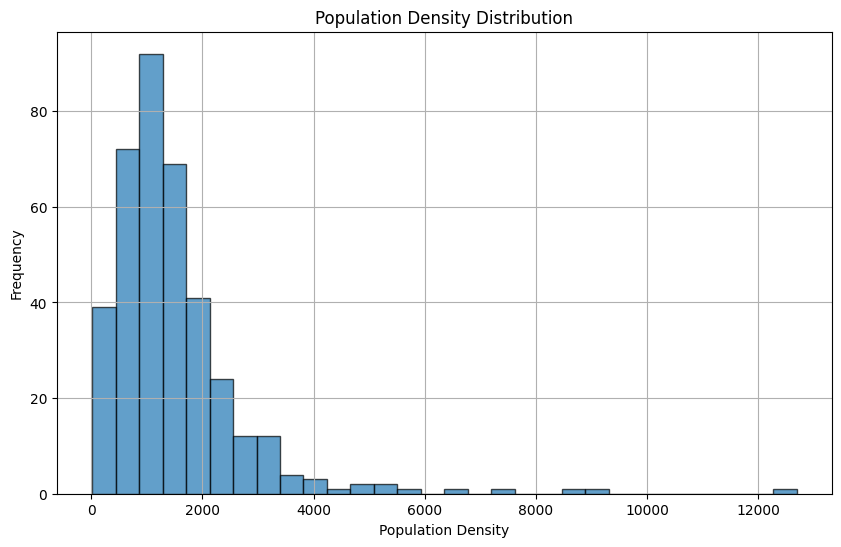

In [24]:
# Plot population density distribution
plt.figure(figsize=(10, 6))
plt.hist(population_data['population_density'], bins=30, edgecolor='k', alpha=0.7)
plt.title('Population Density Distribution')
plt.xlabel('Population Density')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

In [25]:
# Save population data
pop_file, _ = save_data(population_data, 'population', 'geojson')
print(f"\n💾 Population data saved to: {pop_file}")


💾 Population data saved to: /u1/a9dutta/co370/kw-ev-charging-optimization/data/raw/population/population_2024-11-23_20-15-26.geojson


## 4. Transportation Network
Let's analyze the transportation infrastructure.

In [26]:
# Fetch and analyze transportation network
print("\033[1mAnalyzing Transportation Network...\033[0m")
print("=" * 80)

# Use the analyze_transportation_network method
transport_analysis = data_mgr.analyze_transportation_network()

# Display comprehensive statistics
print("\n📊 Network Statistics:")
print("-" * 50)
print(f"Road Network:")
print(f"  Total Length: {transport_analysis['road_network']['total_length']:.1f} km")
print(f"  Density: {transport_analysis['road_network']['density_km_per_km2']:.2f} km/km²")
print(f"  Segments: {transport_analysis['road_network']['stats']['segment_count']:,}")

print("\nTransit Network:")
print(f"  GRT Routes: {transport_analysis['transit_network']['grt_routes']}")
print(f"  GRT Stops: {transport_analysis['transit_network']['grt_stops']}")
print(f"  GRT Network Length: {transport_analysis['transit_network']['grt_length_km']:.1f} km")
print(f"  ION Routes: {transport_analysis['transit_network']['ion_routes']}")
print(f"  ION Stops: {transport_analysis['transit_network']['ion_stops']}")
print(f"  ION Network Length: {transport_analysis['transit_network']['ion_length_km']:.1f} km")

print("\nTransit Coverage:")
print(f"  GRT Coverage: {transport_analysis['transit_coverage']['grt']['coverage_percentage']:.1f}%")
print(f"  ION Coverage: {transport_analysis['transit_coverage']['ion']['coverage_percentage']:.1f}%")

Analyzing Transportation Network...


INFO:src.data.data_manager:Total population: 637,730
INFO:src.data.data_manager:Covered population: 637,040
INFO:src.data.data_manager:Total population: 637,730
INFO:src.data.data_manager:Covered population: 485,640



📊 Network Statistics:
--------------------------------------------------
Road Network:
  Total Length: 339.0 km
  Density: 0.24 km/km²
  Segments: 2,000

Transit Network:
  GRT Routes: 105
  GRT Stops: 1000
  GRT Network Length: 1542.1 km
  ION Routes: 155
  ION Stops: 35
  ION Network Length: 74.1 km

Transit Coverage:
  GRT Coverage: 99.9%
  ION Coverage: 76.2%


In [27]:
m = create_kwc_map("Transportation Network", kwc=True)
m = plot_transportation_network(m, transport_analysis)
draw_map(m)

## 5. EV Ownership Analysis
Let's analyze current EV ownership patterns in the KW region to inform our charging infrastructure needs.

In [28]:
print("\033[1mAnalyzing EV Registration Patterns\033[0m")
print("=" * 80)

# Process FSA data
ev_data = data_mgr.process_ev_fsa_data()

print("\n📊 EV Data Summary:")
print("-" * 50)
total_evs = ev_data['total_ev'].sum()
print(f"FSAs analyzed: {len(ev_data)}")
print(f"Total EVs in KW region: {total_evs:,.0f}")
print(f"- Battery Electric (BEV): {ev_data['bev'].sum():,.0f}")
print(f"- Plug-in Hybrid (PHEV): {ev_data['phev'].sum():,.0f}")

print("\nSpatial Analysis:")
print(f"Total area covered: {ev_data['area_km2'].sum():.1f} km²")
print(f"Average EV density: {ev_data['ev_density'].mean():.1f} EVs/km²")

print("\nEV Distribution by FSA:")
table_data = []
for idx, row in enumerate(ev_data.sort_values('total_ev', ascending=False).itertuples(), start=1):
    table_data.append([
        f"#{idx} [{row.FSA}]",
        f"{row.total_ev:,.0f} EVs ({row.ev_share:.1f}% of region)",
        f"BEV: {row.bev:,.0f} ({row.bev_ratio:.1f}%)",
        f"PHEV: {row.phev:,.0f} ({row.phev_ratio:.1f}%)"
    ])

headers = ["Rank", "Total EVs", "BEV", "PHEV"]
print(tabulate(table_data, headers=headers, tablefmt="grid"))

Analyzing EV Registration Patterns


Processing complete!: 100%|██████████| 6/6 [00:30<00:00,  5.12s/it]       


Boundary File Columns: ['CFSAUID', 'DGUID', 'PRUID', 'PRNAME', 'LANDAREA', 'geometry']

Sample FSA values: 0    A0A
1    A0B
2    A0C
3    A0E
4    A0G
Name: CFSAUID, dtype: object

FSA values in boundary data: ['N0B', 'N1P', 'N1R', 'N1S', 'N1T', 'N2A', 'N2B', 'N2C', 'N2E', 'N2G', 'N2H', 'N2J', 'N2K', 'N2L', 'N2M', 'N2N', 'N2P', 'N2R', 'N2T', 'N2V', 'N3A', 'N3B', 'N3C', 'N3E', 'N3H']

FSA values in EV data: ['N0B', 'N1P', 'N1R', 'N1S', 'N1T', 'N2A', 'N2B', 'N2C', 'N2E', 'N2G', 'N2H', 'N2J', 'N2K', 'N2L', 'N2M', 'N2N', 'N2P', 'N2R', 'N2T', 'N2V', 'N3A', 'N3B', 'N3C', 'N3E', 'N3H']

Final FSA values: ['N0B', 'N1P', 'N1R', 'N1S', 'N1T', 'N2A', 'N2B', 'N2C', 'N2E', 'N2G', 'N2H', 'N2J', 'N2K', 'N2L', 'N2M', 'N2N', 'N2P', 'N2R', 'N2T', 'N2V', 'N3A', 'N3B', 'N3C', 'N3E', 'N3H']

📊 EV Data Summary:
--------------------------------------------------
FSAs analyzed: 25
Total EVs in KW region: 9,881
- Battery Electric (BEV): 7,108
- Plug-in Hybrid (PHEV): 2,773

Spatial Analysis:
Total area cover

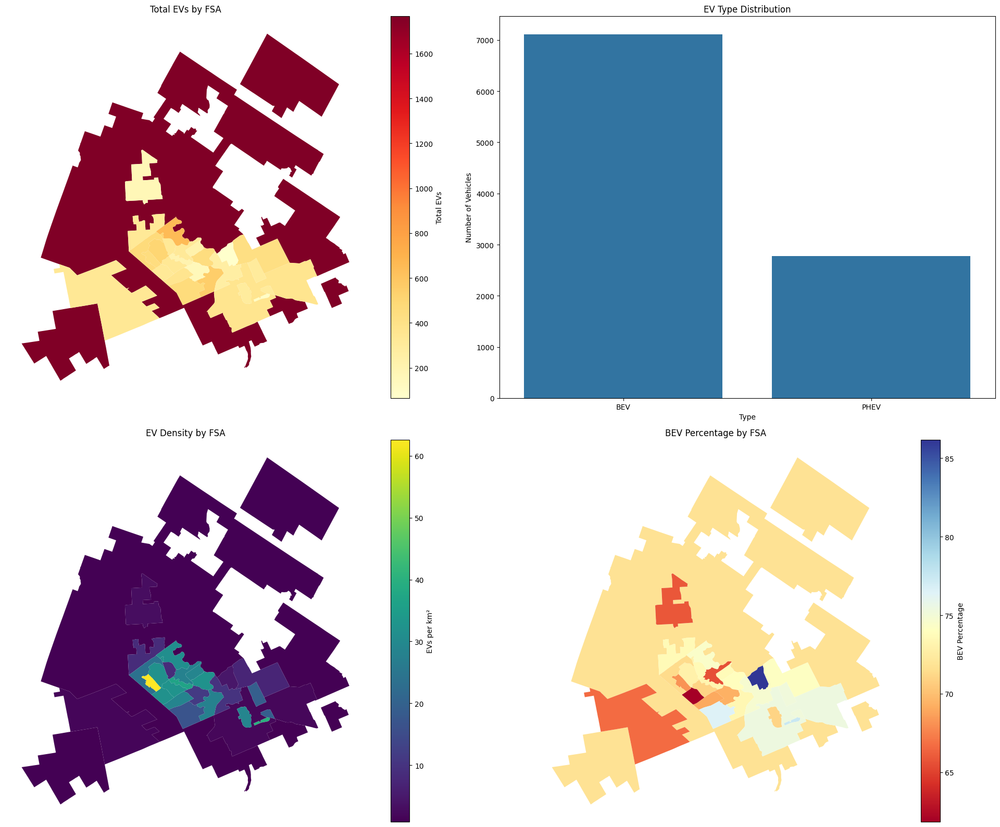

In [29]:
# Create visualizations
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 16))

# 1. EV Distribution by FSA
ev_data.plot(column='total_ev',
             cmap='YlOrRd',
             legend=True,
             legend_kwds={'label': 'Total EVs'},
             ax=ax1)
ax1.set_title('Total EVs by FSA')
ax1.axis('off')

# 2. BEV vs PHEV Distribution
ev_types = pd.DataFrame({
    'Type': ['BEV', 'PHEV'],
    'Count': [ev_data['bev'].sum(), ev_data['phev'].sum()]
})
sns.barplot(data=ev_types, x='Type', y='Count', ax=ax2)
ax2.set_title('EV Type Distribution')
ax2.set_ylabel('Number of Vehicles')

# 3. EV Density
ev_data.plot(column='ev_density',
             cmap='viridis',
             legend=True,
             legend_kwds={'label': 'EVs per km²'},
             ax=ax3)
ax3.set_title('EV Density by FSA')
ax3.axis('off')

# 4. BEV Ratio Distribution
ev_data.plot(column='bev_ratio',
             cmap='RdYlBu',
             legend=True,
             legend_kwds={'label': 'BEV Percentage'},
             ax=ax4)
ax4.set_title('BEV Percentage by FSA')
ax4.axis('off')

plt.tight_layout()
plt.show()

In [30]:
# Create interactive map
print("\nGenerating interactive map...")
m = create_kwc_map("EV Ownership Patterns", kwc=True)

# Create color map for EV density
colormap = cm.LinearColormap(
    colors=['#FFEDA0', '#FEB24C', '#FC4E2A', '#E31A1C'],
    vmin=ev_data['ev_density'].min(),
    vmax=ev_data['ev_density'].max(),
    caption='EVs per km²'
)

# Style function for GeoJSON layer
def style_function(feature):
    density = feature['properties']['ev_density']
    return {
        'fillColor': colormap(density),
        'fillOpacity': 0.7,
        'color': 'black',
        'weight': 1
    }

# Add the styled GeoJSON layer
folium.GeoJson(
    ev_data,
    style_function=style_function,
    tooltip=folium.GeoJsonTooltip(
        fields=['FSA', 'total_ev', 'bev', 'phev', 'ev_density', 'bev_ratio'],
        aliases=['FSA:', 'Total EVs:', 'BEVs:', 'PHEVs:', 'Density (EVs/km²):', 'BEV Ratio (%):'],
        localize=True,
        sticky=False,
        labels=True,
        style=('background-color: white; '
               'color: #333333; '
               'font-family: arial; '
               'font-size: 12px; '
               'padding: 10px;')
    )
).add_to(m)

# Add the colormap legend
m.add_child(colormap)

# Add existing charging stations
m = plot_charging_stations(m, stations_df)

draw_map(m)


Generating interactive map...


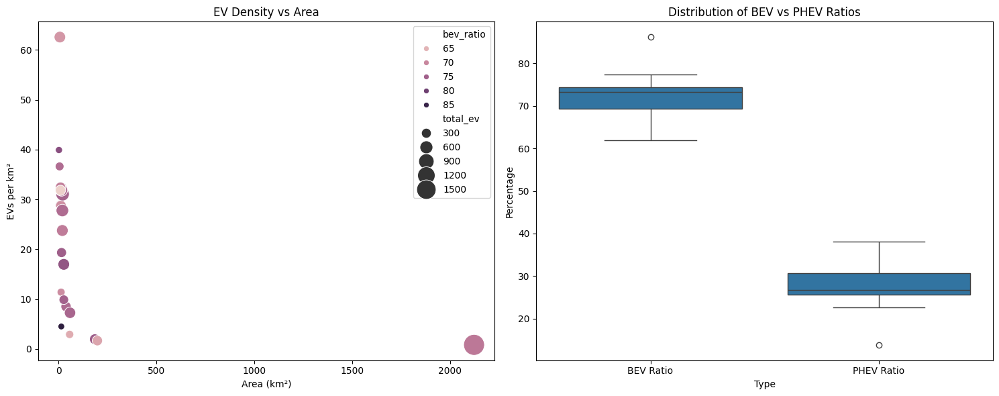


📊 FSA Summary Statistics:


,Min,Max,Mean,Median
Total EVs,65.00,1766.00,395.24,333.00
EV Density,0.83,62.56,21.99,27.77
BEV Ratio,61.85,86.15,72.24,73.21


In [31]:
# Create additional analysis plots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# 1. EV Share vs Area
sns.scatterplot(data=ev_data,
                x='area_km2',
                y='ev_density',
                size='total_ev',
                hue='bev_ratio',
                sizes=(50, 500),
                ax=ax1)
ax1.set_title('EV Density vs Area')
ax1.set_xlabel('Area (km²)')
ax1.set_ylabel('EVs per km²')

# 2. BEV vs PHEV Ratio
ev_data_melted = pd.melt(ev_data,
                         id_vars=['FSA'],
                         value_vars=['bev_ratio', 'phev_ratio'],
                         var_name='Type',
                         value_name='Percentage')
sns.boxplot(data=ev_data_melted,
            x='Type',
            y='Percentage',
            ax=ax2)
ax2.set_title('Distribution of BEV vs PHEV Ratios')
ax2.set_ylabel('Percentage')
ax2.set_xticklabels(['BEV Ratio', 'PHEV Ratio'])

plt.tight_layout()
plt.show()

# Create summary table
print("\n📊 FSA Summary Statistics:")
summary_stats = pd.DataFrame({
    'Min': [ev_data[col].min() for col in ['total_ev', 'ev_density', 'bev_ratio']],
    'Max': [ev_data[col].max() for col in ['total_ev', 'ev_density', 'bev_ratio']],
    'Mean': [ev_data[col].mean() for col in ['total_ev', 'ev_density', 'bev_ratio']],
    'Median': [ev_data[col].median() for col in ['total_ev', 'ev_density', 'bev_ratio']]
}, index=['Total EVs', 'EV Density', 'BEV Ratio'])

display(summary_stats.round(2))

In [32]:
# Save processed data
ev_file, _ = save_data(ev_data, 'ev_fsa_analyzed', 'geojson')
print("\n💾 EV analysis saved!")
print(f"\033[92m✓\033[0m{ev_file}")


💾 EV analysis saved!
✓/u1/a9dutta/co370/kw-ev-charging-optimization/data/processed/ev_fsa_analyzed/ev_fsa_analyzed_2024-11-23_20-16-03.geojson


## 6. Land Use Analysis
Analyze land use patterns and their implications for charging station placement.

In [33]:
print("\033[1mAnalyzing Land Use Patterns...\033[0m")
print("=" * 80)

# Get comprehensive land use analysis
land_use = data_mgr.analyze_land_use()

# Display analysis results
print("\n📊 Land Use Distribution:")
print("-" * 50)
for area_type, metrics in land_use['area_breakdown'].items():
    if area_type != 'total_area_km2':  # Skip the total area entry
        print(f"{area_type.replace('_', ' ').title()}: "
              f"{metrics['area_km2']:.1f} km² "
              f"({metrics['percentage']:.1f}% of region)")

print(f"\nTotal Region Area: {land_use['area_breakdown']['total_area_km2']:.1f} km²")

print("\n📊 Land Use Coverage by Population:")
print("-" * 50)
for use_type, coverage in land_use.items():
    if use_type.endswith('_coverage'):
        use_name = use_type.replace('_coverage', '').replace('_', ' ').title()
        print(f"{use_name}:")
        print(f"  Population Coverage: {coverage['coverage_percentage']:.1f}%")
        print(f"  Population Served: {coverage['covered_population']:,.0f}")

Analyzing Land Use Patterns...


INFO:src.data.data_manager:Total population: 637,730
INFO:src.data.data_manager:Covered population: 661,560
INFO:src.data.data_manager:Total population: 637,730
INFO:src.data.data_manager:Covered population: 2,641,230
INFO:src.data.data_manager:Total population: 637,730
INFO:src.data.data_manager:Covered population: 172,789,790
INFO:src.data.data_manager:Land Use Analysis Summary:
INFO:src.data.data_manager:Total Area: 1384.1 km²
INFO:src.data.data_manager:Business: 0.7 km² (0.1%)
INFO:src.data.data_manager:Downtown: 2.2 km² (0.2%)
INFO:src.data.data_manager:Parks: 19.5 km² (1.4%)



📊 Land Use Distribution:
--------------------------------------------------
Business: 0.7 km² (0.1% of region)
Downtown: 2.2 km² (0.2% of region)
Parks: 19.5 km² (1.4% of region)

Total Region Area: 1384.1 km²

📊 Land Use Coverage by Population:
--------------------------------------------------
Business:
  Population Coverage: 103.7%
  Population Served: 661,560
Downtown:
  Population Coverage: 414.2%
  Population Served: 2,641,230
Parks:
  Population Coverage: 27094.5%
  Population Served: 172,789,790


In [34]:
# Create land use map
m = create_kwc_map("Land Use Analysis", kwc=True)

# Add population density heatmap
m = plot_population_density_map(m)

# Add each land use layer
layers = {
    'Business Areas': land_use['business']['data'],
    'Downtown': land_use['downtown']['data'],
    'Parks': land_use['parks']['data']
}

colors = {
    'Business Areas': '#ff7800',
    'Downtown': '#0078ff',
    'Parks': '#00ff00'
}

for name, gdf in layers.items():
    folium.GeoJson(
        gdf.__geo_interface__,
        name=name,
        style_function=lambda x, color=colors[name]: {
            'fillColor': color,
            'color': '#000000',
            'weight': 1,
            'fillOpacity': 0.35
        }
    ).add_to(m)

draw_map(m)

## 7. Charging Infrastructure Analysis
Comprehensive analysis of existing charging infrastructure and coverage gaps.

In [35]:
print("\033[1mAnalyzing Charging Infrastructure...\033[0m")
print("=" * 80)

# Get comprehensive charging infrastructure analysis using saved data
charging_analysis = data_mgr.analyze_charging_infrastructure()

# Display key statistics with absolute numbers
print("\n📊 Infrastructure Overview:")
print("-" * 50)
print(f"• Stations and Coverage:")
print(f"  - Total Charging Stations: {charging_analysis['station_counts']['total_stations']}")
print(f"  - Total Charging Ports: {charging_analysis['station_counts']['total_chargers']}")
print(f"  - Average Ports per Station: {charging_analysis['station_counts']['avg_chargers_per_station']:.1f}")

print(f"\n• Charger Types:")
charger_types = charging_analysis['charger_types']
for charger_type in charger_types.index:
    count = charger_types.loc[charger_type, ('num_chargers', 'count')]
    total = charger_types.loc[charger_type, ('num_chargers', 'sum')]
    print(f"  - {charger_type}: {count} stations, {total} ports")

print(f"\n• Service Area Coverage:")
for radius in [0.5, 1.0, 5.0]:
    coverage = charging_analysis[f'coverage_{radius}km']
    covered_pop = coverage['covered_population']
    total_pop = coverage['total_population']
    percentage = coverage['coverage_percentage']
    print(f"  - {radius}km radius: {percentage:.1f}% of population")
    print(f"    ({covered_pop:,.0f} out of {total_pop:,.0f} residents)")

Analyzing Charging Infrastructure...


INFO:src.data.data_manager:Generated coverage curve from 0 to 5.0km
INFO:src.data.data_manager:Coverage range: 0.0% - 100.0%
INFO:src.data.data_manager:Total population: 637,730
INFO:src.data.data_manager:Covered population: 589,310
INFO:src.data.data_manager:Total population: 637,730
INFO:src.data.data_manager:Covered population: 620,455
INFO:src.data.data_manager:Total population: 637,730
INFO:src.data.data_manager:Covered population: 637,730



📊 Infrastructure Overview:
--------------------------------------------------
• Stations and Coverage:
  - Total Charging Stations: 183
  - Total Charging Ports: 490
  - Average Ports per Station: 2.7

• Charger Types:
  - Level 2: 166 stations, 423 ports
  - Level 3: 16 stations, 66 ports
  - Unknown: 1 stations, 1 ports

• Service Area Coverage:
  - 0.5km radius: 92.4% of population
    (589,310 out of 637,730 residents)
  - 1.0km radius: 97.3% of population
    (620,455 out of 637,730 residents)
  - 5.0km radius: 100.0% of population
    (637,730 out of 637,730 residents)


In [36]:
# Create coverage analysis map
m = create_kwc_map("Charging Infrastructure Coverage Analysis", kwc=True)

# Add population density
m = plot_population_density_map(m)

# Get GeoDataFrames
stations_gdf = gpd.GeoDataFrame(
    stations_df,
    geometry=gpd.points_from_xy(stations_df.longitude, stations_df.latitude),
    crs="EPSG:4326"
)

# Add 2km and 5km service areas
service_areas_group = folium.FeatureGroup(name='Service Areas')

# Add 5km coverage circles first (as base layer)
for _, station in stations_gdf.iterrows():
    folium.Circle(
        location=[station.geometry.y, station.geometry.x],
        radius=5000,  # 5km in meters
        color='red',
        fill=True,
        fillOpacity=0.05,
        weight=1,
        popup=f"{station['name']}<br>5km coverage"
    ).add_to(service_areas_group)

# Add 2km coverage circles on top
for _, station in stations_gdf.iterrows():
    folium.Circle(
        location=[station.geometry.y, station.geometry.x],
        radius=2000,  # 2km in meters
        color='blue',
        fill=True,
        fillOpacity=0.1,
        weight=1,
        popup=f"{station['name']}<br>2km coverage"
    ).add_to(service_areas_group)

service_areas_group.add_to(m)

# Add charging stations
m = plot_charging_stations(m, stations_df)

# Add potential locations
potential_gdf = gpd.GeoDataFrame(
    potential_df,
    geometry=gpd.points_from_xy(potential_df.longitude, potential_df.latitude),
    crs="EPSG:4326"
)

# Filter to top 50 potential locations by score
if 'score' in potential_df.columns:
    top_locations = potential_gdf.nlargest(50, 'score')
    potential_locations_group = folium.FeatureGroup(name='Top 50 Potential Locations')
    
    for idx, loc in top_locations.iterrows():
        folium.CircleMarker(
            location=[loc.geometry.y, loc.geometry.x],
            radius=6,
            color='green',
            fill=True,
            popup=f"Score: {loc['score']:.2f}<br>Type: {loc['location_type']}",
            tooltip=f"Rank {idx + 1}"
        ).add_to(potential_locations_group)
        
    potential_locations_group.add_to(m)

draw_map(m)

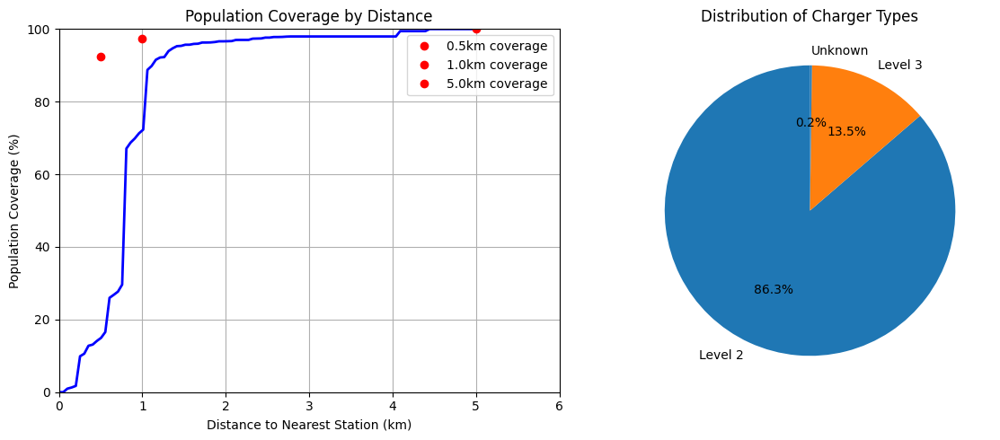

In [37]:
# Create visualization
plt.figure(figsize=(12, 5))

# Plot 1: Coverage vs Distance
plt.subplot(1, 2, 1)
if ('distance_coverage' in charging_analysis and 
    charging_analysis['distance_coverage']['distances'] and 
    charging_analysis['distance_coverage']['coverage_percentages']):
    
    distances = charging_analysis['distance_coverage']['distances']
    coverages = charging_analysis['distance_coverage']['coverage_percentages']
    
    plt.plot(distances, coverages, 'b-', linewidth=2)
    plt.title('Population Coverage by Distance')
    plt.xlabel('Distance to Nearest Station (km)')
    plt.ylabel('Population Coverage (%)')
    plt.grid(True)
    plt.ylim(0, 100)
    plt.xlim(0, 6)
    
    # Add current coverage points
    for radius in [0.5, 1.0, 5.0]:
        coverage = charging_analysis[f'coverage_{radius}km']
        plt.plot(radius, coverage['coverage_percentage'], 'ro', 
                label=f'{radius}km coverage')
    
    plt.legend()
else:
    plt.text(0.5, 0.5, 'No coverage data available', 
             horizontalalignment='center',
             verticalalignment='center')

# Plot 2: Charger Distribution
plt.subplot(1, 2, 2)
charger_counts = charging_analysis['charger_types'][('num_chargers', 'sum')]
colors = ['#1f77b4', '#ff7f0e']  # Blue for Level 2, Orange for Level 3
plt.pie(charger_counts, labels=charger_counts.index, autopct='%1.1f%%',
        colors=colors, startangle=90)
plt.title('Distribution of Charger Types')

plt.tight_layout()
plt.show()

## 8. Save Processed Data
Save all processed data for subsequent analysis notebooks.

In [38]:
print("\033[1m🔍 Kitchener-Waterloo Region Analysis Summary\033[0m")
print("=" * 80)

total_population = population_data['population'].iloc[0:-1].sum()

# Extract the key metrics we want to save
metrics = {
    # Metadata
    'timestamp': [datetime.now().isoformat()],
    'region_area_km2': [area_km2],
    'total_population': [total_population],
    'total_stations': [len(stations_df)],
    'total_potential_locations': [len(potential_df)],
    
    # EV Ownership Data
    'total_evs': [ev_data['total_ev'].sum()],
    'total_bevs': [ev_data['bev'].sum()],
    'total_phevs': [ev_data['phev'].sum()],
    'avg_ev_density': [ev_data['ev_density'].mean()],
    'avg_bev_ratio': [ev_data['bev_ratio'].mean()],
    
    # Charging Infrastructure
    'charging_coverage_500m': [charging_analysis['coverage_0.5km']['coverage_percentage']],
    'charging_coverage_1km': [charging_analysis['coverage_1.0km']['coverage_percentage']],
    'charging_coverage_5km': [charging_analysis['coverage_5.0km']['coverage_percentage']],
    'total_chargers': [charging_analysis['station_counts']['total_chargers']],
    'avg_chargers_per_station': [charging_analysis['station_counts']['avg_chargers_per_station']],
    'level2_chargers': [int(charging_analysis['charger_types'].loc['Level 2', ('num_chargers', 'sum')])],
    'level3_chargers': [int(charging_analysis['charger_types'].loc['Level 3', ('num_chargers', 'sum')])],
    
    # Transportation
    'road_length_km': [transport_analysis['road_network']['total_length']],
    'transit_routes': [transport_analysis['transit_network']['grt_routes'] + transport_analysis['transit_network']['ion_routes']],
    'transit_stops': [transport_analysis['transit_network']['grt_stops'] + transport_analysis['transit_network']['ion_stops']],
    
    # Land Use
    'commercial_area_percentage': [land_use['area_breakdown']['business']['percentage']],
    'downtown_area_percentage': [land_use['area_breakdown']['downtown']['percentage']],
    'parks_area_percentage': [land_use['area_breakdown']['parks']['percentage']]
}

# Create GeoDataFrame with metrics
gdf = gpd.GeoDataFrame(metrics, geometry=boundary.geometry)

# Save to GeoJSON
output_file, _ = save_data(gdf, 'integrated_analyzed_data', 'geojson')
print(f"\n💾 Analysis results saved to: {output_file}")

# Print beautiful summary
print("\n\033[1m📊 Regional Overview\033[0m")
print("━" * 80)
print(f"🌍 Region Size: {area_km2:,.1f} km²")
print(f"👥 Population: {total_population:,.0f} residents")
print(f"📊 Density: {total_population/area_km2:,.1f} people/km²")

print(f"\n\033[1m🚗 EV Ownership\033[0m")
print("━" * 80)
print(f"Total EVs: {ev_data['total_ev'].sum():,.0f}")
print(f"• Battery Electric (BEV): {ev_data['bev'].sum():,.0f} ({ev_data['bev'].sum()/ev_data['total_ev'].sum()*100:.1f}%)")
print(f"• Plug-in Hybrid (PHEV): {ev_data['phev'].sum():,.0f} ({ev_data['phev'].sum()/ev_data['total_ev'].sum()*100:.1f}%)")
print(f"\nEV Density:")
print(f"• Average: {ev_data['ev_density'].mean():.1f} EVs/km²")
print(f"• Range: {ev_data['ev_density'].min():.1f} - {ev_data['ev_density'].max():.1f} EVs/km²")
print(f"\nTop FSAs by EV Count:")
top_fsas = ev_data.nlargest(3, 'total_ev')
for _, row in top_fsas.iterrows():
    print(f"• FSA {row['FSA']}: {row['total_ev']:,.0f} EVs ({row['ev_density']:.1f} EVs/km²)")

print(f"\n\033[1m⚡ EV Charging Infrastructure\033[0m")
print("━" * 80)
print("📍 Charging Stations:")
print(f"   • {len(stations_df)} stations with {charging_analysis['station_counts']['total_chargers']} total charging ports")
print(f"   • {int(charging_analysis['charger_types'].loc['Level 2', ('num_chargers', 'sum')])} Level 2 chargers")
print(f"   • {int(charging_analysis['charger_types'].loc['Level 3', ('num_chargers', 'sum')])} Level 3 DC fast chargers")
print(f"\nCharging Coverage:")
print(f"   • EVs per Charger: {ev_data['total_ev'].sum() / charging_analysis['station_counts']['total_chargers']:.1f}")

print("\n🎯 Population Coverage:")
coverage_500m = charging_analysis['coverage_0.5km']['coverage_percentage']
coverage_1km = charging_analysis['coverage_1.0km']['coverage_percentage']
coverage_5km = charging_analysis['coverage_5.0km']['coverage_percentage']

pop_500m = charging_analysis['coverage_0.5km']['covered_population']
pop_1km = charging_analysis['coverage_1.0km']['covered_population']
pop_5km = charging_analysis['coverage_5.0km']['covered_population']

print("   Walking Distance (500m):")
print(f"   • {coverage_500m:.1f}% of population ({pop_500m:,.0f} residents)")
print("   Biking Distance (1km):")
print(f"   • {coverage_1km:.1f}% of population ({pop_1km:,.0f} residents)")
print("   Driving Distance (5km):")
print(f"   • {coverage_5km:.1f}% of population ({pop_5km:,.0f} residents)")

print(f"\n\033[1m🚌 Transportation Network\033[0m")
print("━" * 80)
road_length = transport_analysis['road_network']['total_length']
transit_routes = transport_analysis['transit_network']['grt_routes'] + transport_analysis['transit_network']['ion_routes']
transit_stops = transport_analysis['transit_network']['grt_stops'] + transport_analysis['transit_network']['ion_stops']

print(f"🛣️  Road Network: {road_length:,.1f} km")
print(f"🚍 Transit Routes: {transit_routes}")
print(f"🚏 Transit Stops: {transit_stops:,}")
print(f"📊 Road Density: {road_length/area_km2:.1f} km/km²")

print(f"\n\033[1m🏙️  Land Use Distribution\033[0m")
print("━" * 80)
commercial_pct = land_use['area_breakdown']['business']['percentage']
downtown_pct = land_use['area_breakdown']['downtown']['percentage']
parks_pct = land_use['area_breakdown']['parks']['percentage']

print(f"💼 Commercial Areas: {commercial_pct:.1f}% of region")
print(f"🏢 Downtown Areas: {downtown_pct:.1f}% of region")
print(f"🌳 Parks and Recreation: {parks_pct:.1f}% of region")

# Add potential locations
print(f"\n\033[1m📍 Future Expansion Potential\033[0m")
print("━" * 80)
print(f"📍 Identified {len(potential_df):,} potential locations for new charging stations")
print("\nTop location types:")
top_types = potential_df['location_type'].value_counts().head()
for loc_type, count in top_types.items():
    print(f"   • {loc_type}: {count:,} sites")

🔍 Kitchener-Waterloo Region Analysis Summary

💾 Analysis results saved to: /u1/a9dutta/co370/kw-ev-charging-optimization/data/processed/integrated_analyzed_data/integrated_analyzed_data_2024-11-23_20-16-07.geojson

📊 Regional Overview
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
🌍 Region Size: 1,384.1 km²
👥 Population: 637,730 residents
📊 Density: 460.7 people/km²

🚗 EV Ownership
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
Total EVs: 9,881
• Battery Electric (BEV): 7,108 (71.9%)
• Plug-in Hybrid (PHEV): 2,773 (28.1%)

EV Density:
• Average: 22.0 EVs/km²
• Range: 0.8 - 62.6 EVs/km²

Top FSAs by EV Count:
• FSA N0B: 1,766 EVs (0.8 EVs/km²)
• FSA N2K: 653 EVs (31.1 EVs/km²)
• FSA N2P: 552 EVs (27.8 EVs/km²)

⚡ EV Charging Infrastructure
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
📍 Charging Stations:
   • 183 stations with 490 total charging ports
   • 423 Level 2 chargers
   • 66